<a href="https://colab.research.google.com/github/22bcs12781/SENTIMENT-ANALYSIS/blob/main/ISENTIMENT_ANALYSIS_PROJECT_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [2]:
!pip install deepface

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 7.7 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 108.6/108.6 kB 8.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 85.0/85.0 kB 7.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.9/1.9 MB 63.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 62.9 MB/s eta 0:00:00
  Created wheel for fire: filename=fire-0.7.0-py3-none-any.whl size=114249 sha256=935fac143b0cbaa3e31f0669fe3fc5662cd60b8707970535eadbc172e31e1405
  Stored in directory: /root/.cache/pip/wheels/46/54/24/1624fd5b8674eb1188623f7e8e17cdf7c0f6c24b609dfb8a89
Successfully built fire


Please upload an image file for analysis.


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Saving IMG_0710.jpeg to IMG_0710 (1).jpeg


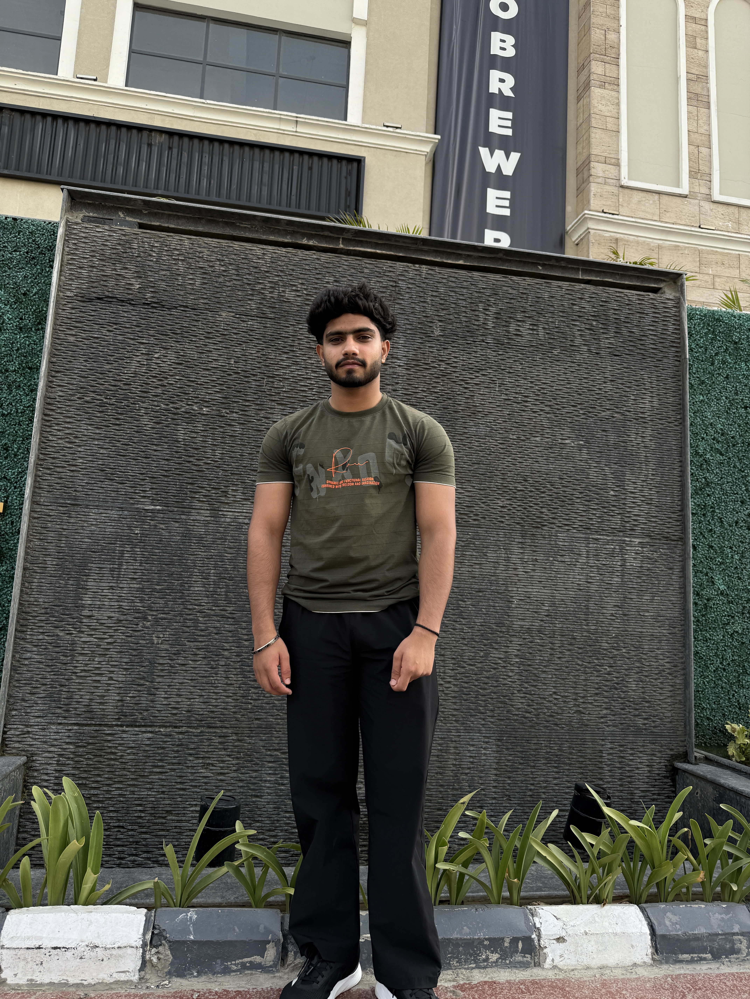

Downloading...
From: https://github.com/serengil/deepface_models/releases/download/v1.0/facial_expression_model_weights.h5
To: /root/.deepface/weights/facial_expression_model_weights.h5


25-06-13 14:33:54 - facial_expression_model_weights.h5 will be downloaded...


100%|██████████| 5.98M/5.98M [00:00<00:00, 227MB/s]


Error in emotion detection: list indices must be integers or slices, not str


In [4]:
from google.colab.patches import cv2_imshow
import cv2
from deepface import DeepFace
from nltk.sentiment.vader import SentimentIntensityAnalyzer
import nltk

# Download required NLTK data
nltk.download('vader_lexicon')

# Initialize sentiment analyzer
analyzer = SentimentIntensityAnalyzer()

def analyze_emotion_to_sentiment(emotion):
    emotion_to_sentiment = {
        "happy": {"pos": 1.0, "neg": 0.0, "neu": 0.0, "compound": 0.7},
        "sad": {"pos": 0.0, "neg": 1.0, "neu": 0.0, "compound": -0.6},
        "angry": {"pos": 0.0, "neg": 1.0, "neu": 0.0, "compound": -0.8},
        "neutral": {"pos": 0.0, "neg": 0.0, "neu": 1.0, "compound": 0.0},
        "surprise": {"pos": 0.8, "neg": 0.0, "neu": 0.2, "compound": 0.5},
    }
    return emotion_to_sentiment.get(emotion.lower(), {"pos": 0.0, "neg": 0.0, "neu": 1.0, "compound": 0.0})

# File upload interface
from google.colab import files

def main():
    print("Please upload an image file for analysis.")
    uploaded = files.upload()  # Upload an image file
    for file_name in uploaded.keys():
        img_path = file_name

        # Read and analyze the image
        img = cv2.imread(/content/IMG_0710.jpeg)
        cv2_imshow(img)  # Display the uploaded image

        try:
            analysis = DeepFace.analyze(img, actions=['emotion'], enforce_detection=False)
            emotion = analysis['dominant_emotion']
            sentiment_score = analyze_emotion_to_sentiment(emotion)

            print(f"Emotion: {emotion}")
            print(f"Sentiment Score: Pos={sentiment_score['pos']}, Neg={sentiment_score['neg']}, Neu={sentiment_score['neu']}")
        except Exception as e:
            print("Error in emotion detection:", e)

if __name__ == "__main__":
    main()


In [5]:
import cv2
cap = cv2.VideoCapture(0)
if cap.isOpened():
    print("Camera is accessible.")
else:
    print("Camera is not accessible.")
cap.release()


Camera is not accessible.


In [6]:
import requests
from bs4 import BeautifulSoup
import nltk
from nltk.sentiment import SentimentIntensityAnalyzer
import pandas as pd

# Download VADER lexicon for sentiment analysis
nltk.download('vader_lexicon')

# Initialize the sentiment analyzer
sia = SentimentIntensityAnalyzer()

# Function to analyze sentiment
def analyze_sentiment(text):
    sentiment_score = sia.polarity_scores(text)
    compound_score = sentiment_score['compound']

    # Determine sentiment label based on compound score
    if compound_score >= 0.05:
        sentiment_label = 'Positive'
    elif compound_score <= -0.05:
        sentiment_label = 'Negative'
    else:
        sentiment_label = 'Neutral'

    # Return both the sentiment label and the compound score
    return sentiment_label, compound_score

def get_article_details_dainik_bhaskar(html_content):
    soup = BeautifulSoup(html_content, 'html.parser')
    headline_elem = soup.find('h1')
    description_elem = soup.find('meta', {'name': 'description'})

    headline = headline_elem.text.strip() if headline_elem else 'N/A'
    description = description_elem['content'].strip() if description_elem and 'content' in description_elem.attrs else 'N/A'

    # Analyze sentiment of headline and description
    headline_sentiment, headline_score = analyze_sentiment(headline)
    description_sentiment, description_score = analyze_sentiment(description)

    return {
        'headline': headline,
        'headline_sentiment': headline_sentiment,
        'headline_score': headline_score,
        'description': description,
        'description_sentiment': description_sentiment,
        'description_score': description_score,
    }

def get_article_details_dainik_jagran(html_content):
    soup = BeautifulSoup(html_content, 'html.parser')
    headline_elem = soup.find('h1')
    description_elem = soup.find('meta', {'name': 'description'})

    headline = headline_elem.text.strip() if headline_elem else 'N/A'
    description = description_elem['content'].strip() if description_elem and 'content' in description_elem.attrs else 'N/A'

    # Analyze sentiment of headline and description
    headline_sentiment, headline_score = analyze_sentiment(headline)
    description_sentiment, description_score = analyze_sentiment(description)

    return {
        'headline': headline,
        'headline_sentiment': headline_sentiment,
        'headline_score': headline_score,
        'description': description,
        'description_sentiment': description_sentiment,
        'description_score': description_score,
    }

def get_article_details_times_of_india(html_content):
    soup = BeautifulSoup(html_content, 'html.parser')
    headline_elem = soup.find('h1', class_='headline')  # Adjust this if needed based on ToI's actual structure
    description_elem = soup.find('meta', {'name': 'description'})

    headline = headline_elem.text.strip() if headline_elem else 'N/A'
    description = description_elem['content'].strip() if description_elem and 'content' in description_elem.attrs else 'N/A'

    # Analyze sentiment of headline and description
    headline_sentiment, headline_score = analyze_sentiment(headline)
    description_sentiment, description_score = analyze_sentiment(description)

    return {
        'headline': headline,
        'headline_sentiment': headline_sentiment,
        'headline_score': headline_score,
        'description': description,
        'description_sentiment': description_sentiment,
        'description_score': description_score,
    }

def scrape_multiple_articles(base_url, article_urls, get_article_details_func):
    headers = {
        'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) AppleWebKit/537.36 (KHTML, like Gecko) Chrome/91.0.4472.124 Safari/537.36'
    }
    articles = []
    for url in article_urls:
        full_url = base_url + url
        response = requests.get(full_url, headers=headers)
        if response.status_code == 200:
            article_details = get_article_details_func(response.content)
            articles.append(article_details)
        else:
            print(f"Failed to fetch article details from {full_url}. Status code: {response.status_code}")
    return articles

if __name__ == '__main__':
    newspapers = [
        {
            'base_url': 'https://www.bhaskar.com/',
            'article_urls': [
                'mohan-bhagwat-said-manipur-is-waiting-for-peace-133149916.html',
                'pm-narendra-modi-political-story-explained-rajnath-singh-lk-advani-nitish-kumar-bjp-alliance-132787669.html',
                'karnataka-valmiki-corporation-scam-exposed-ubi-bank-manger-congress-133152757.html',
            ],
            'get_article_details_func': get_article_details_dainik_bhaskar
        },
        {
            'base_url': 'https://www.jagran.com/',
            'article_urls': [
                'news/national-pm-modi-to-address-nation-21973197.html',
                'news/national-india-covid-cases-21973198.html',
                'news/international-us-president-to-visit-india-21973199.html',
            ],
            'get_article_details_func': get_article_details_dainik_jagran
        },
        {
            'base_url': 'https://timesofindia.indiatimes.com/',
            'article_urls': [
                'bhubaneswar/odisha-searches-for-a-house-for-its-new-chief-minister/articleshow/110883646.cms',
                'youtuber-shot-dead-as-india-vs-pakistan-question-irritates-security-guard-who-didnt-want-to-be-filmed/articleshow/110897884.cms',
                'tragic-death-of-17-year-old-in-aligarh-sparks-controversy-over-police-harassment-claims/articleshow/115061393.cms',
                'haryana-mob-lynching-meat-sample-from-migrant-workers-house-not-beef-says-police/articleshow/114612208.cms'
            ],
            'get_article_details_func': get_article_details_times_of_india
        }
    ]

    all_articles = []
    for newspaper in newspapers:
        articles = scrape_multiple_articles(
            newspaper['base_url'],
            newspaper['article_urls'],
            newspaper['get_article_details_func']
        )
        all_articles.extend(articles)

    # Create a DataFrame to display results in a table format
    articles_df = pd.DataFrame(all_articles)

    # Display the table
    print(articles_df)


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


                                            headline headline_sentiment  \
0  RSS चीफ भागवत बोले- काम करें, अहंकार न पालें:च...            Neutral   
1  मैं भारत का पीएममोदी की उम्मीदवारी पर आडवाणी ब...            Neutral   
2  15 फेक अकाउंट, फर्जी साइन और 94 करोड़ गायब:एक ...            Neutral   
3  नक्सलियों की टोह में पुलिस और पीएसी के जवानों ...            Neutral   
4   पुलिस से झड़प करने में ट्रक चालक व खलासी गिरफ्तार            Neutral   
5        किसानों को कृषि ऋण देने की गति धीमी, मायूसी            Neutral   
6                                                N/A            Neutral   
7                                                N/A            Neutral   
8                                                N/A            Neutral   
9                                                N/A            Neutral   

   headline_score                                        description  \
0             0.0  RSS चीफ मोहन भागवत सोमवार 10 जून को नागपुर में...   
1             0.0  9 जून 2013 

In [7]:
import csv
import random

# Sample sentences for each sentiment
positive_sentences = [
    "I am feeling fantastic today!",
    "What a wonderful experience.",
    "This product exceeded my expectations.",
    "I am very happy with the service.",
    "Everything is going great!"
]

negative_sentences = [
    "I am very disappointed.",
    "This was a terrible experience.",
    "The product didn't work as expected.",
    "I'm not happy with the service.",
    "Today has been awful."
]

neutral_sentences = [
    "The weather is okay.",
    "I went to the store.",
    "It's just another regular day.",
    "I have a meeting later.",
    "The food was decent."
]

# Generating 100 random sentences with labels
data = []
for _ in range(100):
    sentiment = random.choice(["positive", "negative", "neutral"])
    if sentiment == "positive":
        sentence = random.choice(positive_sentences)
    elif sentiment == "negative":
        sentence = random.choice(negative_sentences)
    else:
        sentence = random.choice(neutral_sentences)

    data.append([sentence, sentiment])

# Writing data to CSV file
with open('sentences_with_sentiment.csv', mode='w', newline='') as file:
    writer = csv.writer(file)
    writer.writerow(['Sentence', 'Sentiment'])
    writer.writerows(data)

print("CSV file generated successfully.")


CSV file generated successfully.


In [8]:
pip install tabulate


In [9]:
import csv
from textblob import TextBlob
from tabulate import tabulate

# Function to calculate polarity
def get_polarity(sentence):
    return TextBlob(sentence).sentiment.polarity

# Read the CSV file and analyze the sentiment
input_file = 'sentences_with_sentiment.csv'

data = []

# Open and read the input CSV file
with open(input_file, mode='r', newline='') as file:
    reader = csv.reader(file)
    header = next(reader)  # Skip header
    for row in reader:
        sentence = row[0]
        sentiment = row[1]
        polarity = get_polarity(sentence)  # Calculate polarity score
        data.append([sentence, sentiment, polarity])

# Display results in a table format
headers = ['Sentence', 'Sentiment', 'Polarity Score']
print(tabulate(data, headers=headers, tablefmt='pretty'))


+----------------------------------------+-----------+---------------------+
|                Sentence                | Sentiment |   Polarity Score    |
+----------------------------------------+-----------+---------------------+
|   I am very happy with the service.    | positive  |         1.0         |
|   I am very happy with the service.    | positive  |         1.0         |
|         Today has been awful.          | negative  |        -1.0         |
|          The food was decent.          |  neutral  | 0.16666666666666666 |
|     It's just another regular day.     |  neutral  |         0.0         |
|     It's just another regular day.     |  neutral  |         0.0         |
|       Everything is going great!       | positive  |         1.0         |
|  The product didn't work as expected.  | negative  |        -0.1         |
|      What a wonderful experience.      | positive  |         1.0         |
|    This was a terrible experience.     | negative  |        -1.0         |

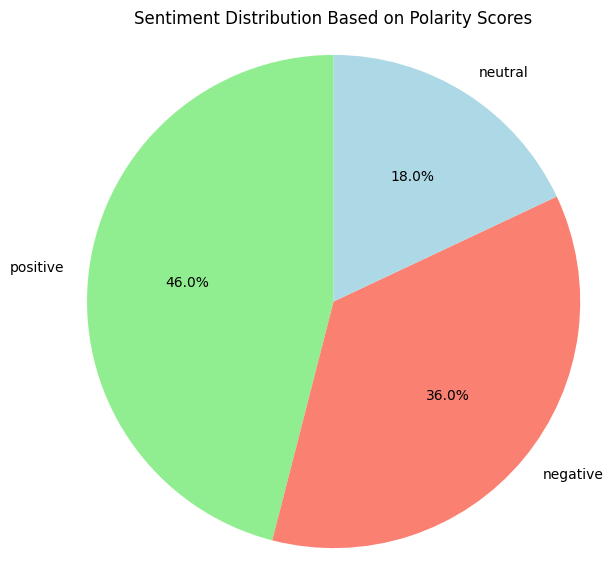

In [10]:
import csv
from textblob import TextBlob
import matplotlib.pyplot as plt

# Function to calculate polarity
def get_polarity(sentence):
    return TextBlob(sentence).sentiment.polarity

# Function to classify sentiment based on polarity score
def classify_sentiment(polarity):
    if polarity > 0:
        return "positive"
    elif polarity < 0:
        return "negative"
    else:
        return "neutral"

# Read the CSV file and analyze the sentiment
input_file = 'sentences_with_sentiment.csv'

sentiment_count = {"positive": 0, "negative": 0, "neutral": 0}

# Open and read the input CSV file
with open(input_file, mode='r', newline='') as file:
    reader = csv.reader(file)
    header = next(reader)  # Skip header
    for row in reader:
        sentence = row[0]
        polarity = get_polarity(sentence)  # Calculate polarity score
        classified_sentiment = classify_sentiment(polarity)  # Classify sentiment

        # Count sentiment occurrences
        sentiment_count[classified_sentiment] += 1

# Plot pie chart based on sentiment counts
labels = sentiment_count.keys()
sizes = sentiment_count.values()

plt.figure(figsize=(7, 7))
plt.pie(sizes, labels=labels, autopct='%1.1f%%', startangle=90, colors=['lightgreen', 'salmon', 'lightblue'])
plt.title('Sentiment Distribution Based on Polarity Scores')
plt.axis('equal')  # Equal aspect ratio ensures the pie chart is circular.
plt.show()


In [11]:
import csv
from textblob import TextBlob
from sklearn.model_selection import train_test_split
from sklearn.naive_bayes import MultinomialNB
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, classification_report

# Function to calculate polarity
def get_polarity(sentence):
    return TextBlob(sentence).sentiment.polarity

# Function to classify sentiment based on polarity score
def classify_sentiment(polarity):
    if polarity > 0:
        return "positive"
    elif polarity < 0:
        return "negative"
    else:
        return "neutral"

# Read the CSV file and analyze the sentiment
input_file = 'sentences_with_sentiment.csv'

sentences = []
labels = []

# Open and read the input CSV file
with open(input_file, mode='r', newline='') as file:
    reader = csv.reader(file)
    header = next(reader)  # Skip header
    for row in reader:
        sentence = row[0]
        polarity = get_polarity(sentence)  # Calculate polarity score
        classified_sentiment = classify_sentiment(polarity)  # Classify sentiment

        sentences.append(sentence)
        labels.append(classified_sentiment)

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(sentences, labels, test_size=0.2, random_state=42)

# Convert text data into numerical features (using CountVectorizer)
vectorizer = CountVectorizer()
X_train_vectorized = vectorizer.fit_transform(X_train)
X_test_vectorized = vectorizer.transform(X_test)

# Initialize and train the Naive Bayes classifier
classifier = MultinomialNB()
classifier.fit(X_train_vectorized, y_train)

# Predict the labels for the test set
y_pred = classifier.predict(X_test_vectorized)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy * 100:.2f}%')

# Print classification report
print("\nClassification Report:\n", classification_report(y_test, y_pred))


Accuracy: 90.00%

Classification Report:
               precision    recall  f1-score   support

    negative       0.71      1.00      0.83         5
     neutral       1.00      1.00      1.00         3
    positive       1.00      0.83      0.91        12

    accuracy                           0.90        20
   macro avg       0.90      0.94      0.91        20
weighted avg       0.93      0.90      0.90        20



In [12]:
import csv
from textblob import TextBlob
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.metrics import accuracy_score, classification_report

# Function to calculate polarity
def get_polarity(sentence):
    return TextBlob(sentence).sentiment.polarity

# Function to classify sentiment based on polarity score
def classify_sentiment(polarity):
    if polarity > 0:
        return "positive"
    elif polarity < 0:
        return "negative"
    else:
        return "neutral"

# Read the CSV file and analyze the sentiment
input_file = 'sentences_with_sentiment.csv'

sentences = []
labels = []

# Open and read the input CSV file
with open(input_file, mode='r', newline='') as file:
    reader = csv.reader(file)
    header = next(reader)  # Skip header
    for row in reader:
        sentence = row[0]
        polarity = get_polarity(sentence)  # Calculate polarity score
        classified_sentiment = classify_sentiment(polarity)  # Classify sentiment

        sentences.append(sentence)
        labels.append(classified_sentiment)

# Split the data into training and testing sets (80% training, 20% testing)
X_train, X_test, y_train, y_test = train_test_split(sentences, labels, test_size=0.2, random_state=42)

# Convert text data into numerical features (using CountVectorizer)
vectorizer = CountVectorizer()
X_train_vectorized = vectorizer.fit_transform(X_train)
X_test_vectorized = vectorizer.transform(X_test)

# List of models to train and evaluate
models = {
    "Logistic Regression": LogisticRegression(),
    "Support Vector Machine": SVC(),
    "Naive Bayes": MultinomialNB(),
    "Random Forest": RandomForestClassifier(),
    "K-Nearest Neighbors": KNeighborsClassifier()
}

# Train, predict, and evaluate each model
for model_name, model in models.items():
    # Train the model
    model.fit(X_train_vectorized, y_train)

    # Predict the labels for the test set
    y_pred = model.predict(X_test_vectorized)

    # Evaluate the model
    accuracy = accuracy_score(y_test, y_pred)
    print(f"\n{model_name} Accuracy: {accuracy * 100:.2f}%")

    # Print classification report
    print(f"\n{model_name} Classification Report:\n", classification_report(y_test, y_pred))



Logistic Regression Accuracy: 100.00%

Logistic Regression Classification Report:
               precision    recall  f1-score   support

    negative       1.00      1.00      1.00         5
     neutral       1.00      1.00      1.00         3
    positive       1.00      1.00      1.00        12

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20


Support Vector Machine Accuracy: 100.00%

Support Vector Machine Classification Report:
               precision    recall  f1-score   support

    negative       1.00      1.00      1.00         5
     neutral       1.00      1.00      1.00         3
    positive       1.00      1.00      1.00        12

    accuracy                           1.00        20
   macro avg       1.00      1.00      1.00        20
weighted avg       1.00      1.00      1.00        20


Naive Bayes Accuracy: 90.00%

Naive Bayes Classification Report

In [13]:
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer

# Download the VADER lexicon
nltk.download('vader_lexicon')

def analyze_sentiment(text):
    analyzer = SentimentIntensityAnalyzer()
    sentiment_score = analyzer.polarity_scores(text)

    # Calculate polarity score (this is just the compound score)
    polarity_score = sentiment_score['compound']

    return sentiment_score, polarity_score

def main():
    while True:
        user_input = input("Enter the text for the sentiment analysis: ")
        sentiment_score, polarity_score = analyze_sentiment(user_input)

        print("Sentiment Score:")
        print("Positive:", sentiment_score['pos'])
        print("Negative:", sentiment_score['neg'])
        print("Neutral:", sentiment_score['neu'])
        print("Compound:", sentiment_score['compound'])
        print("Polarity Score:", polarity_score)

        another_input = input("Do you want to analyze another text? (yes/no): ").strip().lower()
        if another_input != 'yes':
            break

if __name__ == "__main__":
    main()


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Enter the text for the sentiment analysis: FUCK OFF
Sentiment Score:
Positive: 0.0
Negative: 0.778
Neutral: 0.222
Compound: -0.5423
Polarity Score: -0.5423
Do you want to analyze another text? (yes/no): NO


In [14]:
pip install pytesseract pillow opencv-python-headless nltk deepface


In [15]:
# Install necessary packages and Tesseract
!apt-get install tesseract-ocr
!pip install pytesseract pillow nltk

# Import libraries
import pytesseract
from PIL import Image
import nltk
from nltk.sentiment.vader import SentimentIntensityAnalyzer
from google.colab import files

# Download VADER lexicon for NLTK (only needs to be done once)
nltk.download('vader_lexicon')

# Preprocessing function to enhance OCR accuracy
def preprocess_image(image_path):
    img = Image.open(image_path)
    img = img.convert('L')  # Convert to grayscale
    img = img.point(lambda p: p > 200 and 255)  # Apply a threshold to enhance contrast
    return img

# Function to extract text from image using OCR
def extract_text_from_image(image_path):
    try:
        # Preprocess image before OCR
        img = preprocess_image(image_path)
        # Use pytesseract to extract text
        text = pytesseract.image_to_string(img)
        return text
    except Exception as e:
        return f"Error extracting text from {image_path}: {str(e)}"

# Function to analyze sentiment of extracted text
def analyze_sentiment(text):
    analyzer = SentimentIntensityAnalyzer()
    sentiment_score = analyzer.polarity_scores(text)
    polarity_score = sentiment_score['compound']
    return sentiment_score, polarity_score

# Main function to process multiple images
def predict_sentiment_from_images(image_paths):
    for image_path in image_paths:
        print(f"\nProcessing image: {image_path}")

        # Step 1: Extract text from image
        extracted_text = extract_text_from_image(image_path)
        if extracted_text.strip() == "":
            print("No text found in the image.")
        else:
            print(f"Extracted Text: {extracted_text}")

            # Step 2: Perform sentiment analysis
            sentiment_score, polarity_score = analyze_sentiment(extracted_text)

            print("Sentiment Score (Text):")
            print("Positive:", sentiment_score['pos'])
            print("Negative:", sentiment_score['neg'])
            print("Neutral:", sentiment_score['neu'])
            print("Compound (overall):", sentiment_score['compound'])
            print("Polarity Score (Text):", polarity_score)

# Upload images for analysis
uploaded = files.upload()

# Process the uploaded images
image_paths = list(uploaded.keys())
predict_sentiment_from_images(image_paths)


Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
tesseract-ocr is already the newest version (4.1.1-2.1build1).
0 upgraded, 0 newly installed, 0 to remove and 35 not upgraded.


[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


Saving IMG_0617.jpeg to IMG_0617.jpeg

Processing image: IMG_0617.jpeg
Extracted Text:  

 

 

Ce
an
‘ Sd
{
H
r VA
.
(
—
a
ta a
-. et
aT li
ne ag ,

Sentiment Score (Text):
Positive: 0.0
Negative: 0.0
Neutral: 1.0
Compound (overall): 0.0
Polarity Score (Text): 0.0


In [18]:
!pip install opencv-python fer


  Using cached fer-22.5.1-py3-none-any.whl.metadata (6.4 kB)
  Using cached facenet_pytorch-2.6.0-py3-none-any.whl.metadata (12 kB)
  Using cached torchvision-0.17.2-cp311-cp311-manylinux1_x86_64.whl.metadata (6.6 kB)
Using cached fer-22.5.1-py3-none-any.whl (1.5 MB)
Using cached facenet_pytorch-2.6.0-py3-none-any.whl (1.9 MB)
Using cached torchvision-0.17.2-cp311-cp311-manylinux1_x86_64.whl (6.9 MB)
  Attempting uninstall: torchvision
    Found existing installation: torchvision 0.21.0+cu124
    Uninstalling torchvision-0.21.0+cu124:
      Successfully uninstalled torchvision-0.21.0+cu124


In [19]:
# Import Libraries
import cv2
from fer import FER  # For facial expression recognition
from google.colab import files

# Function to analyze facial expressions in the image
def analyze_facial_expression(image_path):
    # Load the image using OpenCV
    img = cv2.imread(image_path)
    # Convert the image to RGB
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    # Initialize the FER detector
    detector = FER()

    # Analyze emotions
    emotions, score = detector.top_emotion(img_rgb)

    return emotions, score

# Main function to process images for facial emotion analysis
def predict_facial_expression_from_images(image_paths):
    for image_path in image_paths:
        print(f"\nProcessing image: {image_path}")

        # Step 1: Analyze facial expression in the image
        emotions, score = analyze_facial_expression(image_path)
        print(f"Facial Expression: {emotions} with confidence score: {score}")

# Upload images for analysis
uploaded = files.upload()

# Process the uploaded images
image_paths = list(uploaded.keys())
predict_facial_expression_from_images(image_paths)


Saving IMG_0401.jpeg to IMG_0401.jpeg

Processing image: IMG_0401.jpeg
Facial Expression: sad with confidence score: 0.28
